In [1]:
import sys
sys.path.append('../')

import os
import gc
import torch
import psutil
import pickle
import numpy as np
import pandas as pd
import torch.nn as nn
import torch.nn.functional as F
from sklearn import metrics
from collections import Counter
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader
from torchvision import models, set_image_backend

import data_utils
import train_utils
import model_utils

%reload_ext autoreload
%autoreload 2

set_image_backend('accimage')

In [2]:
pickle_file = '/n/data_labeled_histopathology_images/COAD/train.pkl'
with open(pickle_file, 'rb') as f: 
    train_embeddings, train_labels, train_jpgs_to_slide = pickle.load(f)
    
pickle_file = '/n/data_labeled_histopathology_images/COAD/val.pkl'
with open(pickle_file, 'rb') as f: 
    val_embeddings, val_labels, val_jpgs_to_slide = pickle.load(f)

In [12]:
root_dir = data_utils.root_dir_coad
sa_train, sa_val = data_utils.process_WGD_data()
output_shape = 1
transform_val = train_utils.transform_validation
val_set = data_utils.TCGADataset_tiles(sa_val, root_dir, transform=transform_val, 
                                               magnification='10.0', all_cancers=False, cancer_type=['COAD'])

In [14]:
input_size = 2048
hidden_size = 2048
output_size = 1
criterion = nn.BCELoss(reduction='none')
n_samples = val_jpgs_to_slide.max() + 1
probs_vec = torch.zeros((n_samples, 1)).cuda()
labels_vec = torch.zeros_like(probs_vec).cuda()
val_embeddings = val_embeddings.cuda()

In [15]:
def pool_fn(x):
    #v,a = torch.max(x,0)
    v = torch.mean(x,0)
    return v

In [16]:
state_dict_file = '/n/tcga_models/COAD_rationale_model_gen_5_10_acc.pt'
output_size = 2
gen = model_utils.Generator(input_size, hidden_size, output_size, dropout=0.5)
saved_state = torch.load(state_dict_file, map_location=lambda storage, loc:storage)
gen.load_state_dict(saved_state)
for p in gen.parameters():
    p.requires_grad = False
gen.cuda()

Generator(
  (d): Dropout(p=0.5)
  (m): ReLU()
  (linear1): Linear(in_features=2048, out_features=2048, bias=True)
  (linear2): Linear(in_features=2048, out_features=2, bias=True)
)

In [17]:
state_dict_file = '/n/tcga_models/COAD_rationale_model_enc_5_10_acc.pt'
output_size = 1
enc = model_utils.Encoder(input_size, hidden_size, output_size, pool_fn, dropout=0.5)
saved_state = torch.load(state_dict_file, map_location=lambda storage, loc:storage)
enc.load_state_dict(saved_state)
for p in enc.parameters():
    p.requires_grad = False
enc.cuda()

Encoder(
  (d): Dropout(p=0.5)
  (m): ReLU()
  (linear1): Linear(in_features=2048, out_features=2048, bias=True)
  (linear2): Linear(in_features=2048, out_features=1, bias=True)
)

In [18]:
gen.eval()
enc.eval()
with torch.no_grad():
    for idx in range(n_samples):
        slide = val_embeddings[val_jpgs_to_slide==idx]
        labels_vec[idx] = val_labels[val_jpgs_to_slide==idx].unique().float().cuda()

        preds = gen(slide)
        sample = torch.argmax(preds, dim=1).float()
        rationale = slide * sample.unsqueeze(1)

        logits = enc(rationale)
        probs_vec[idx] = torch.sigmoid(logits).float() # mean pooling the tile-level predicted labels
        if labels_vec[idx]==1:
            break

In [32]:
slide_number = idx
jpegs = val_set.jpegs[idx]
rationale_jpegs = [jpegs[i] for i,s in enumerate(sample) if s==1]


In [38]:
base_path = val_set.img_dirs[idx]
print(base_path+'/'+rationale_jpegs[0])

/n/mounted-data-drive/COAD/TCGA-AZ-6606-01Z-00-DX1.aa79b3d8-8ff1-4171-96dc-94bc7d073d93.svs/TCGA-AZ-6606-01Z-00-DX1.aa79b3d8-8ff1-4171-96dc-94bc7d073d93_files/10.0/36_26.jpeg


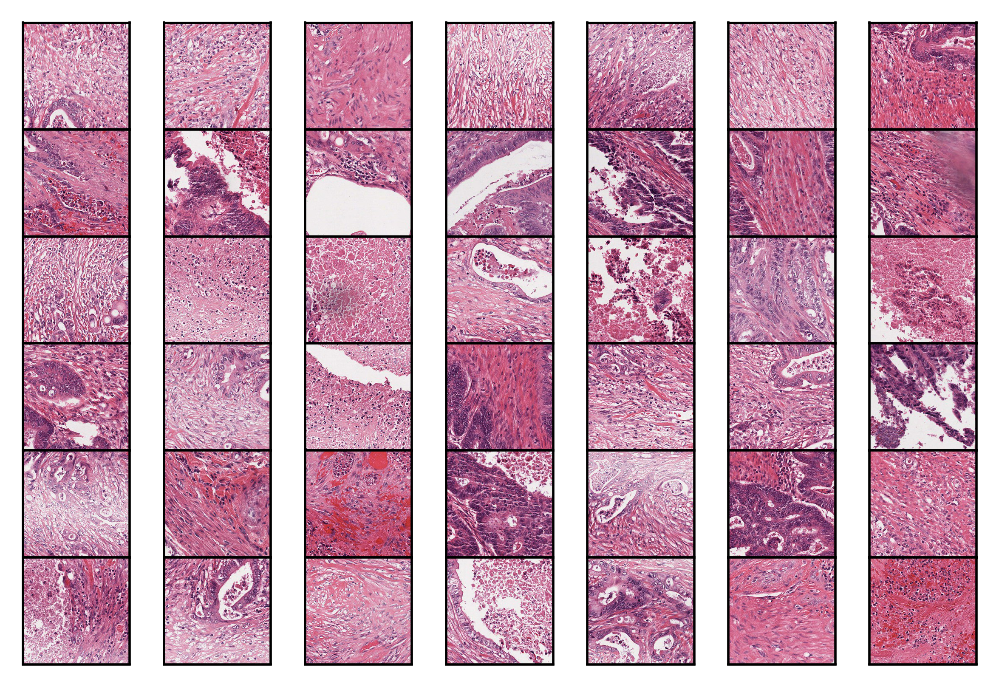

In [58]:
f, axarr = plt.subplots(6, 7, gridspec_kw = {'wspace':0, 'hspace':0})
x = 0
y = 0
for ix,jp in enumerate(rationale_jpegs[:-1]):
    image = data_utils.pil_loader(base_path+'/'+jp)
    f.axes[ix].grid(False)
    f.axes[ix].imshow(image)
    f.axes[ix].set_xticks([])
    f.axes[ix].set_yticks([])
f.set_dpi(500)


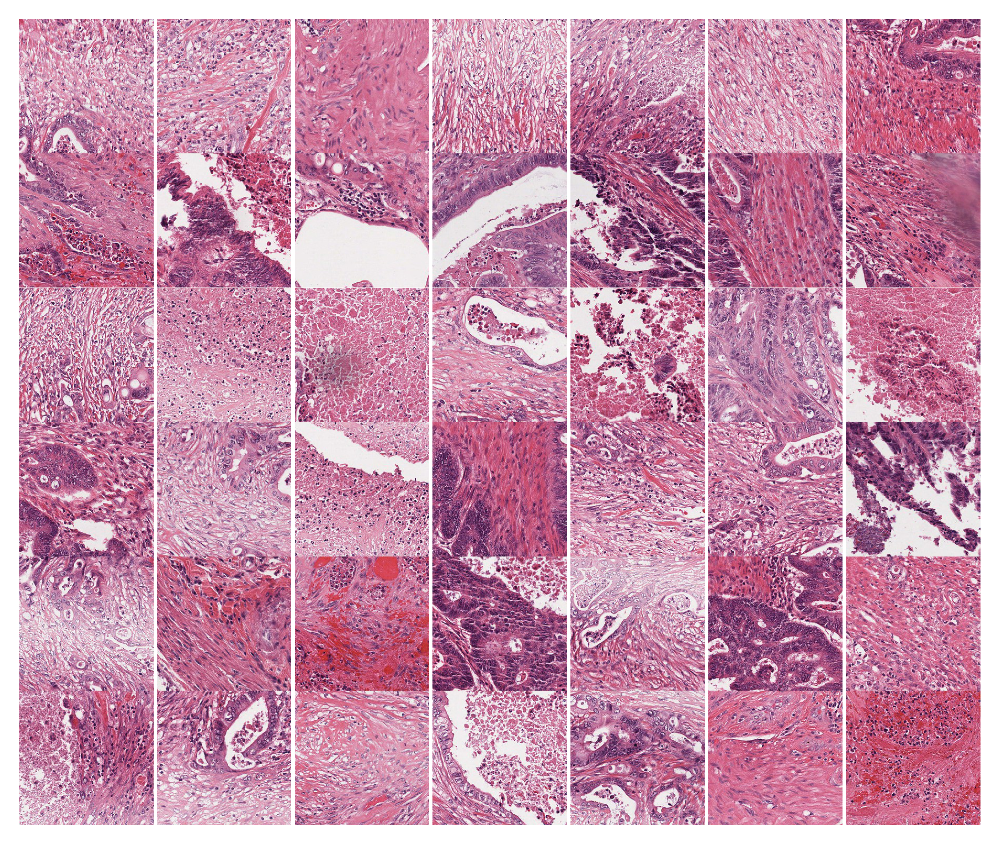

In [65]:
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec

fig = plt.figure(figsize = (7,7))
gs1 = gridspec.GridSpec(7, 7)
gs1.update(wspace=0.0, hspace=0.0) # set the spacing between axes. 

for i in range(42):
    ax1 = plt.subplot(gs1[i])
    image = data_utils.pil_loader(base_path+'/'+rationale_jpegs[i])
    ax1.imshow(image)
    ax1.set_xticklabels([])
    ax1.set_yticklabels([])
    ax1.set_xticks([])
    ax1.set_yticks([])
    plt.box(on=None)
    #ax1.set_aspect('equal')
fig.set_dpi(500)
plt.show()


In [150]:
def viz_rationale(val_set,sample,rationale_index,slide_number):
    # get path and jpegs
    base_path = val_set.img_dirs[slide_number]
    jpegs = val_set.jpegs[slide_number]
    # get rationales
    rationale_jpegs = [jpegs[i] for i,s in enumerate(sample) if s==1]
    #image = data_utils.pil_loader(base_path+'/'+rationale_jpegs[rationale_index])
    #plt.imshow(image)
    # get coordinates of the rationale
    r_idx = np.argwhere(sample.cpu().numpy())[rationale_index]
    r_coords = val_set.coords[slide_number][r_idx]
    # get the neighborhood
    all_coords = val_set.coords[slide_number]
    n_coords = all_coords[torch.sqrt(torch.sum(torch.pow(all_coords - r_coords,2).float(),1))  <= np.sqrt(2)]
    neighbors = np.argwhere(torch.sqrt(torch.sum(torch.pow(all_coords - r_coords,2).float(),1)).cpu().numpy()  <= np.sqrt(2))
    
    # plot them all
    plt_coords = n_coords - r_coords + 1
    fig = plt.figure(figsize = (3,3))
    gs1 = gridspec.GridSpec(3, 3)
    gs1.update(wspace=0.00, hspace=0.01) # set the spacing between axes. 

    for (x,y),i in zip(plt_coords.numpy(),neighbors):
        ax1 = plt.subplot(gs1[y,x])
        image = data_utils.pil_loader(base_path+'/'+val_set.jpegs[slide_number][i[0]])
        ax1.imshow(image)
        ax1.set_xticklabels([])
        ax1.set_yticklabels([])
        ax1.set_xticks([])
        ax1.set_yticks([])
        plt.box(on=None)
        #ax1.set_aspect('equal')
    fig.set_dpi(500)
    plt.show()
    return fig

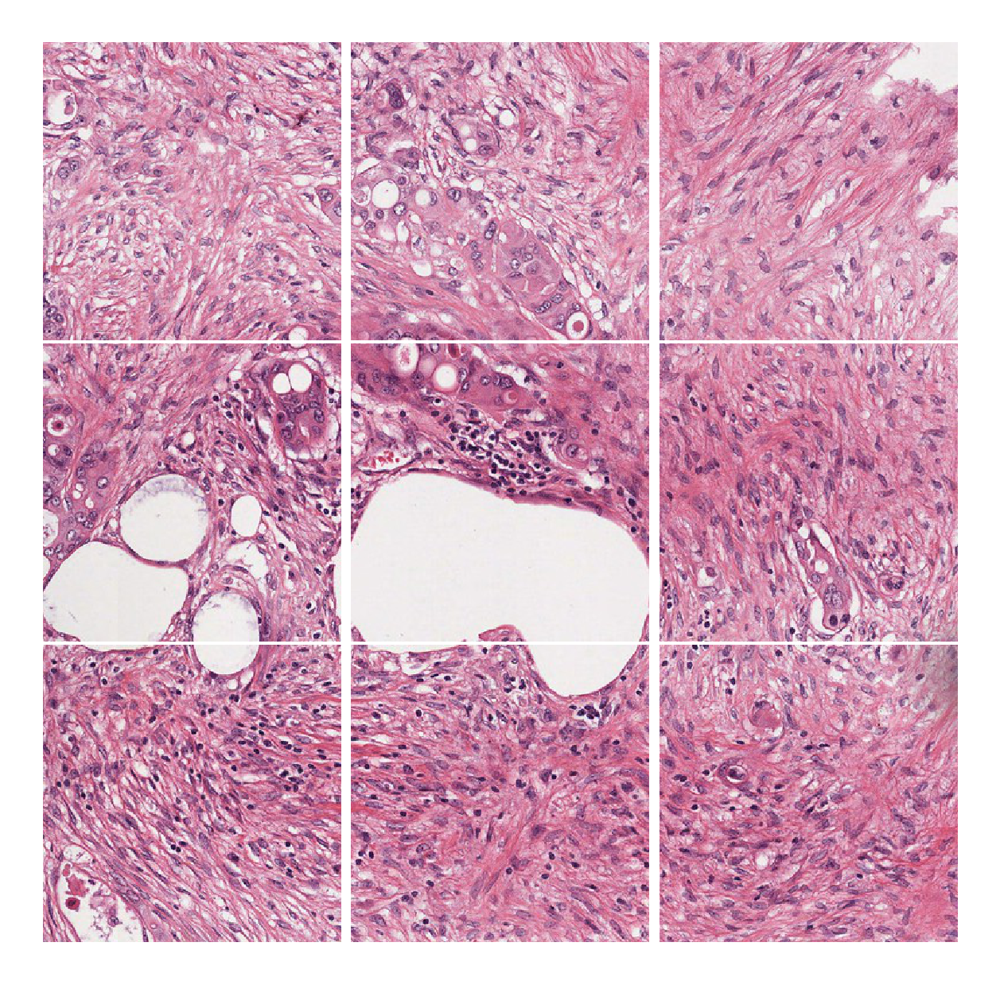

In [151]:
fig = viz_rationale(val_set,sample,9,slide_number)

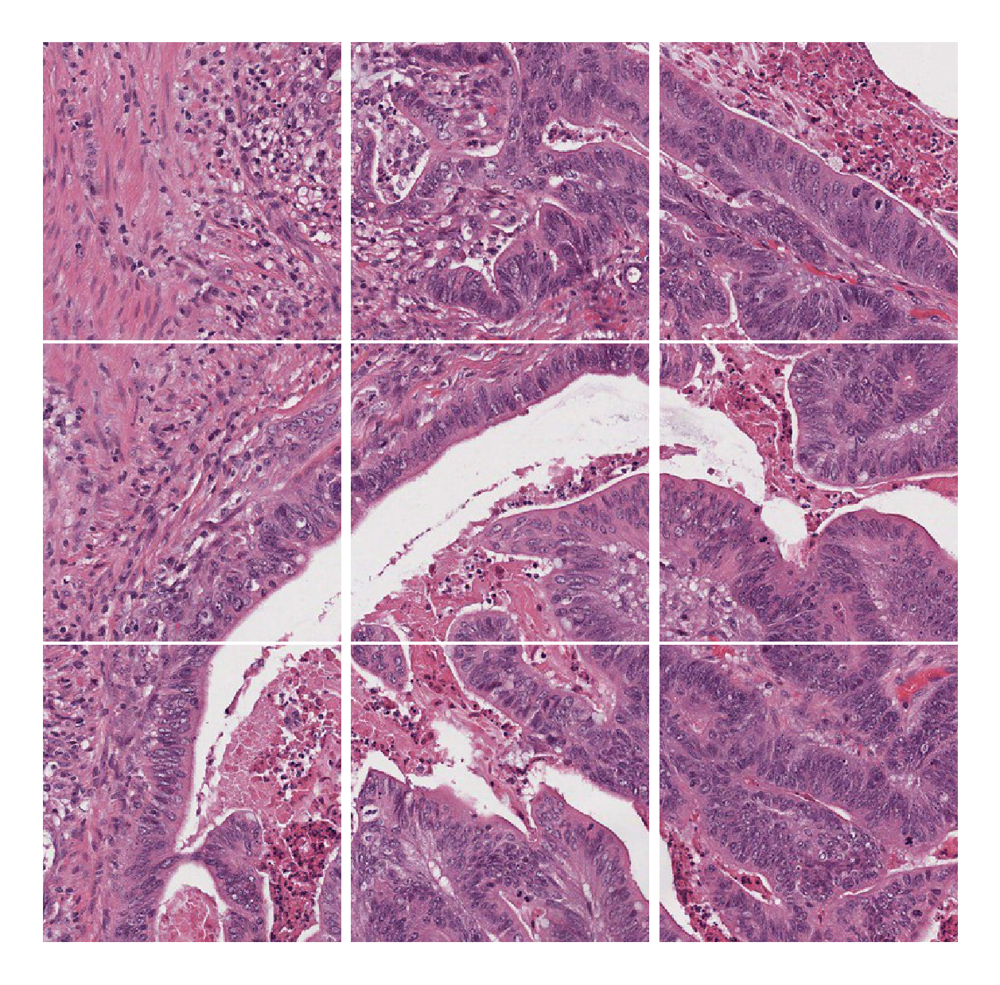

In [152]:
fig = viz_rationale(val_set,sample,10,slide_number)